## Final Project: Churn Analysis

The objective of this project is to help PowerCo., a gas and electricity distribution company, anticipate customer churn that would ultimately help them save those customers. After analyzing the data and applying around 7 machine learning algorithms, we achieved an accuracy of 90% and a recall of 76% on the test data. This indicates our models’ ability to predict customer churn and offers an opportunity to explore a discounted rate of 20% as a potential solution.


In [1]:
!pip install pandas-profiling

(Asad)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 19.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 353.0/353.0 kB 32.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 11.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 44.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 28.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 41.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 84.2 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=f6e7e6df8aa1de143137d1870b2dd6dfb746c7ed61fa0ac988930307ef5c30c8
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: wordcloud
    Found existing installation: wordcloud 1.8.2.2
    Uninstalling wordc

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings("ignore")

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import BernoulliNB, GaussianNB
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, f1_score, auc, classification_report, precision_score, recall_score

from sklearn.metrics import classification_report

from sklearn.pipeline import make_pipeline



# Models
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import RidgeClassifier, LogisticRegression

from sklearn.model_selection import GridSearchCV

from sklearn.ensemble import GradientBoostingClassifier



from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.metrics import roc_curve, auc

(Asad and Parkash)



![image.png](attachment:image.png)

In [3]:
client = pd.read_csv('client_data.csv')
client.head()

(Asad)

,id,channel_sales,cons_12m,cons_gas_12m,cons_last_month,date_activ,date_end,date_modif_prod,date_renewal,forecast_cons_12m,...,has_gas,imp_cons,margin_gross_pow_ele,margin_net_pow_ele,nb_prod_act,net_margin,num_years_antig,origin_up,pow_max,churn
0,24011ae4ebbe3035111d65fa7c15bc57,foosdfpfkusacimwkcsosbicdxkicaua,0,54946,0,2013-06-15,2016-06-15,2015-11-01,2015-06-23,0.00,...,t,0.00,25.44,25.44,2,678.99,3,lxidpiddsbxsbosboudacockeimpuepw,43.648,1
1,d29c2c54acc38ff3c0614d0a653813dd,MISSING,4660,0,0,2009-08-21,2016-08-30,2009-08-21,2015-08-31,189.95,...,f,0.00,16.38,16.38,1,18.89,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,13.800,0
2,764c75f661154dac3a6c254cd082ea7d,foosdfpfkusacimwkcsosbicdxkicaua,544,0,0,2010-04-16,2016-04-16,2010-04-16,2015-04-17,47.96,...,f,0.00,28.60,28.60,1,6.60,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,13.856,0
3,bba03439a292a1e166f80264c16191cb,lmkebamcaaclubfxadlmueccxoimlema,1584,0,0,2010-03-30,2016-03-30,2010-03-30,2015-03-31,240.04,...,f,0.00,30.22,30.22,1,25.46,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,13.200,0
4,149d57cf92fc41cf94415803a877cb4b,MISSING,4425,0,526,2010-01-13,2016-03-07,2010-01-13,2015-03-09,445.75,...,f,52.32,44.91,44.91,1,47.98,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,19.800,0


In [4]:
df = client
df.head()

(Asad)

,id,channel_sales,cons_12m,cons_gas_12m,cons_last_month,date_activ,date_end,date_modif_prod,date_renewal,forecast_cons_12m,...,has_gas,imp_cons,margin_gross_pow_ele,margin_net_pow_ele,nb_prod_act,net_margin,num_years_antig,origin_up,pow_max,churn
0,24011ae4ebbe3035111d65fa7c15bc57,foosdfpfkusacimwkcsosbicdxkicaua,0,54946,0,2013-06-15,2016-06-15,2015-11-01,2015-06-23,0.00,...,t,0.00,25.44,25.44,2,678.99,3,lxidpiddsbxsbosboudacockeimpuepw,43.648,1
1,d29c2c54acc38ff3c0614d0a653813dd,MISSING,4660,0,0,2009-08-21,2016-08-30,2009-08-21,2015-08-31,189.95,...,f,0.00,16.38,16.38,1,18.89,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,13.800,0
2,764c75f661154dac3a6c254cd082ea7d,foosdfpfkusacimwkcsosbicdxkicaua,544,0,0,2010-04-16,2016-04-16,2010-04-16,2015-04-17,47.96,...,f,0.00,28.60,28.60,1,6.60,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,13.856,0
3,bba03439a292a1e166f80264c16191cb,lmkebamcaaclubfxadlmueccxoimlema,1584,0,0,2010-03-30,2016-03-30,2010-03-30,2015-03-31,240.04,...,f,0.00,30.22,30.22,1,25.46,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,13.200,0
4,149d57cf92fc41cf94415803a877cb4b,MISSING,4425,0,526,2010-01-13,2016-03-07,2010-01-13,2015-03-09,445.75,...,f,52.32,44.91,44.91,1,47.98,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,19.800,0


In [5]:
df = df[['cons_12m', 'cons_gas_12m', 'cons_last_month',
       'forecast_cons_12m', 'forecast_cons_year', 'forecast_discount_energy',
       'forecast_meter_rent_12m', 'forecast_price_energy_off_peak',
       'forecast_price_energy_peak', 'forecast_price_pow_off_peak', 'has_gas',
       'imp_cons', 'margin_gross_pow_ele', 'margin_net_pow_ele', 'nb_prod_act',
       'net_margin', 'num_years_antig', 'pow_max', 'churn']]

(Asad)

In [6]:
df.has_gas = df.has_gas.map({'t' : 0, 'f' : 1})

(Asad)

In [7]:
df.shape

(Asad)

(14606, 19)

In [8]:
df.isnull().sum()

(Asad)

cons_12m                          0
cons_gas_12m                      0
cons_last_month                   0
forecast_cons_12m                 0
forecast_cons_year                0
forecast_discount_energy          0
forecast_meter_rent_12m           0
forecast_price_energy_off_peak    0
forecast_price_energy_peak        0
forecast_price_pow_off_peak       0
has_gas                           0
imp_cons                          0
margin_gross_pow_ele              0
margin_net_pow_ele                0
nb_prod_act                       0
net_margin                        0
num_years_antig                   0
pow_max                           0
churn                             0
dtype: int64

In [9]:
df.info()

(Asad)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14606 entries, 0 to 14605
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   cons_12m                        14606 non-null  int64  
 1   cons_gas_12m                    14606 non-null  int64  
 2   cons_last_month                 14606 non-null  int64  
 3   forecast_cons_12m               14606 non-null  float64
 4   forecast_cons_year              14606 non-null  int64  
 5   forecast_discount_energy        14606 non-null  float64
 6   forecast_meter_rent_12m         14606 non-null  float64
 7   forecast_price_energy_off_peak  14606 non-null  float64
 8   forecast_price_energy_peak      14606 non-null  float64
 9   forecast_price_pow_off_peak     14606 non-null  float64
 10  has_gas                         14606 non-null  int64  
 11  imp_cons                        14606 non-null  float64
 12  margin_gross_pow_ele            

In [10]:
df.describe().T

(Asad)

,count,mean,std,min,25%,50%,75%,max
cons_12m,14606.0,159220.286252,573465.264198,0.0,5674.750000,14115.500000,40763.750000,6.207104e+06
cons_gas_12m,14606.0,28092.375325,162973.059057,0.0,0.000000,0.000000,0.000000,4.154590e+06
cons_last_month,14606.0,16090.269752,64364.196422,0.0,0.000000,792.500000,3383.000000,7.712030e+05
forecast_cons_12m,14606.0,1868.614880,2387.571531,0.0,494.995000,1112.875000,2401.790000,8.290283e+04
forecast_cons_year,14606.0,1399.762906,3247.786255,0.0,0.000000,314.000000,1745.750000,1.753750e+05
forecast_discount_energy,14606.0,0.966726,5.108289,0.0,0.000000,0.000000,0.000000,3.000000e+01
forecast_meter_rent_12m,14606.0,63.086871,66.165783,0.0,16.180000,18.795000,131.030000,5.993100e+02
forecast_price_energy_off_peak,14606.0,0.137283,0.024623,0.0,0.116340,0.143166,0.146348,2.739630e-01
forecast_price_energy_peak,14606.0,0.050491,0.049037,0.0,0.000000,0.084138,0.098837,1.959750e-01
forecast_price_pow_off_peak,14606.0,43.130056,4.485988,0.0,40.606701,44.311378,44.311378,5.926638e+01


In [11]:
df.head()

(Asad)

,cons_12m,cons_gas_12m,cons_last_month,forecast_cons_12m,forecast_cons_year,forecast_discount_energy,forecast_meter_rent_12m,forecast_price_energy_off_peak,forecast_price_energy_peak,forecast_price_pow_off_peak,has_gas,imp_cons,margin_gross_pow_ele,margin_net_pow_ele,nb_prod_act,net_margin,num_years_antig,pow_max,churn
0,0,54946,0,0.00,0,0.0,1.78,0.114481,0.098142,40.606701,0,0.00,25.44,25.44,2,678.99,3,43.648,1
1,4660,0,0,189.95,0,0.0,16.27,0.145711,0.000000,44.311378,1,0.00,16.38,16.38,1,18.89,6,13.800,0
2,544,0,0,47.96,0,0.0,38.72,0.165794,0.087899,44.311378,1,0.00,28.60,28.60,1,6.60,6,13.856,0
3,1584,0,0,240.04,0,0.0,19.83,0.146694,0.000000,44.311378,1,0.00,30.22,30.22,1,25.46,6,13.200,0
4,4425,0,526,445.75,526,0.0,131.73,0.116900,0.100015,40.606701,1,52.32,44.91,44.91,1,47.98,6,19.800,0


#### Comments:

The class variable *churn* is not balanced, so besides accuracy, we'll need to look at precision and recall as well. Sience churn has lower share, so our metric of interest is recall

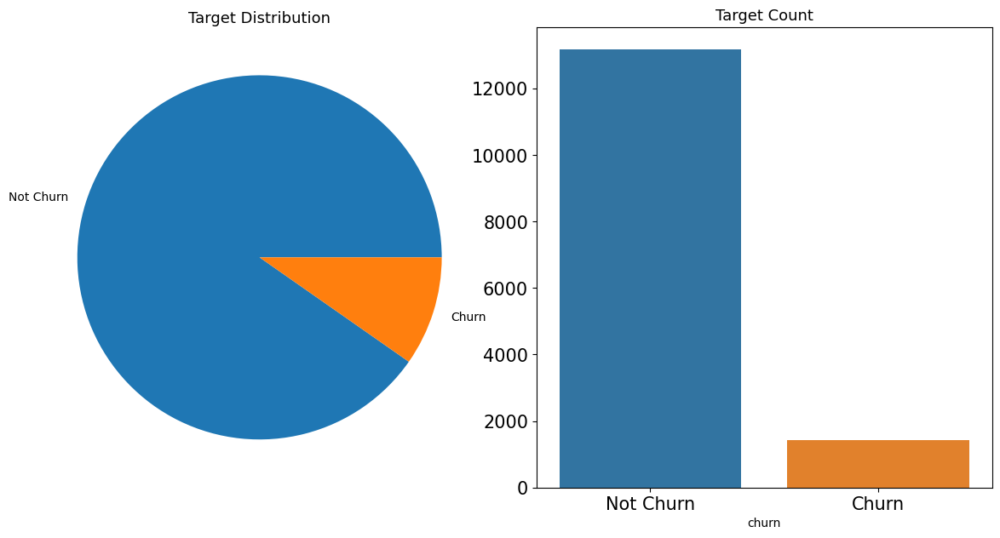

In [12]:
fig, axes  = plt.subplots(ncols = 2, figsize = (12, 6) , dpi = 100)
plt.tight_layout()

df.groupby('churn').count()['cons_12m'].plot(kind = 'pie', ax = axes[0], labels = ['Not Churn', 'Churn'])
sns.countplot(x = df['churn'], ax = axes[1])

axes[0].set_ylabel('')
axes[1].set_ylabel('')
axes[1].set_xticklabels(['Not Churn', 'Churn'])
axes[0].tick_params(axis='x', labelsize=15)
axes[0].tick_params(axis='y', labelsize=15)
axes[1].tick_params(axis='x', labelsize=15)
axes[1].tick_params(axis='y', labelsize=15)

axes[0].set_title('Target Distribution', fontsize=13)
axes[1].set_title('Target Count', fontsize=13)

plt.show()

(Asad)

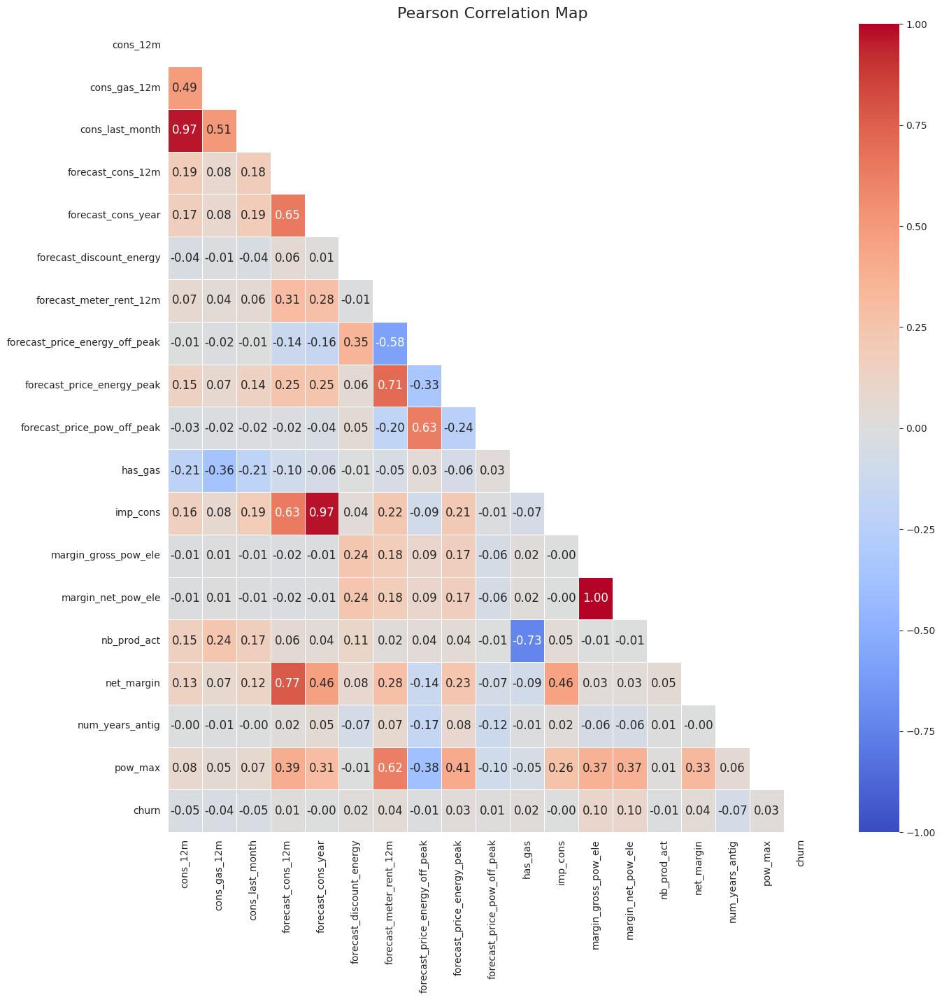

In [13]:
#Compute the Correlation matrix with all the features
sns.set_style("white")
corr_all = df.corr(method="pearson")
matrix = np.triu(corr_all)
fig, ax = plt.subplots(figsize=(15, 15))
axis_labels = df.columns

sns.heatmap(corr_all, xticklabels=axis_labels, yticklabels=axis_labels, annot=True, fmt=".2f", ax=ax,
            vmin=-1, vmax=1, mask=matrix, cmap="coolwarm", linewidth=0.4, linecolor="white", annot_kws={"size": 12})
plt.xticks(rotation=90, size=10)
plt.yticks(rotation=0, size=10)
plt.title('Pearson Correlation Map', size=16)
plt.show()

(Asad)

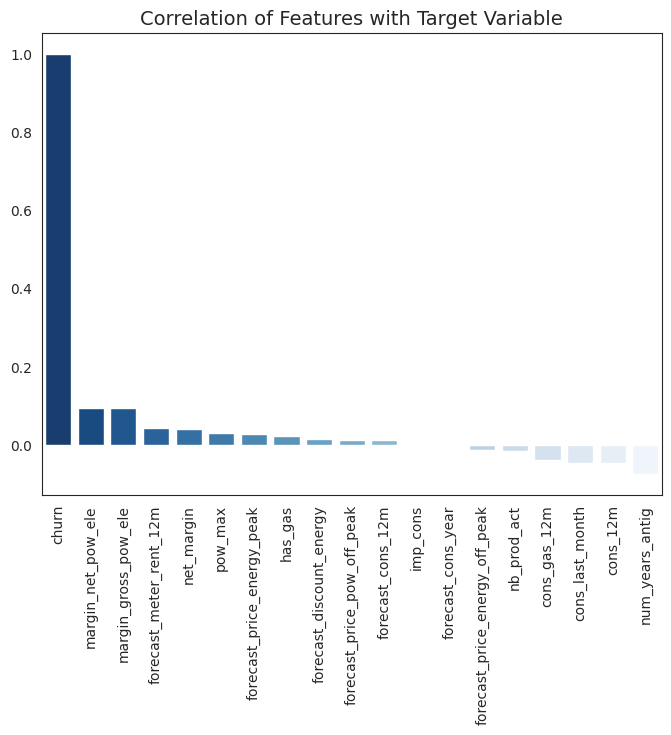

In [14]:
# Compute the correlation matrix with the target variable
corr = df.corr()['churn']
corr_sort = corr.sort_values(ascending=False)
fig, ax = plt.subplots(figsize=(8, 6))
sns.barplot(x=corr_sort.index, y=corr_sort.values, palette="Blues_r")
plt.xticks(rotation=90, size=10)
plt.yticks(size=10)
plt.title('Correlation of Features with Target Variable', size=14)
plt.show()

(Asad)

**Pandas Profiling: EDA**

In [15]:
import pandas_profiling as pp

pp.ProfileReport(df)

(Asad)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [16]:
X = df.drop('churn', axis = 1)
y = df['churn']

(Parkash)

### Normalising the data

In [17]:
cols = X.columns
std = StandardScaler()
X = std.fit_transform(X)
X = pd.DataFrame(data = X, columns = cols)
X.head()

(Parkash)

,cons_12m,cons_gas_12m,cons_last_month,forecast_cons_12m,forecast_cons_year,forecast_discount_energy,forecast_meter_rent_12m,forecast_price_energy_off_peak,forecast_price_energy_peak,forecast_price_pow_off_peak,has_gas,imp_cons,margin_gross_pow_ele,margin_net_pow_ele,nb_prod_act,net_margin,num_years_antig,pow_max
0,-0.277655,0.164779,-0.249996,-0.782669,-0.431005,-0.189253,-0.926596,-0.926092,0.971783,-0.562516,-2.123586,-0.447586,0.043246,0.043376,0.997048,1.570703,-1.239571,1.885055
1,-0.269529,-0.172380,-0.249996,-0.703109,-0.431005,-0.189253,-0.707593,0.342284,-1.029692,0.263345,0.470901,-0.447586,-0.404594,-0.404483,-0.411900,-0.546444,0.621825,-0.320308
2,-0.276707,-0.172380,-0.249996,-0.762581,-0.431005,-0.189253,-0.368283,1.157936,0.762891,0.263345,0.470901,-0.447586,0.199446,0.199583,-0.411900,-0.585862,0.621825,-0.316170
3,-0.274893,-0.172380,-0.249996,-0.682129,-0.431005,-0.189253,-0.653787,0.382208,-1.029692,0.263345,0.470901,-0.447586,0.279523,0.279664,-0.411900,-0.525372,0.621825,-0.364640
4,-0.269939,-0.172380,-0.241824,-0.595967,-0.269043,-0.189253,1.037477,-0.827847,1.009981,-0.562516,0.470901,-0.294316,1.005655,1.005828,-0.411900,-0.453144,0.621825,0.123011


### Splitting data into training and testing data with 80-20 rule.

In [18]:
xtrain, xtest, ytrain, ytest = train_test_split(X, y, test_size = 0.20, random_state = 42)

(Parkash)

In [19]:
xtrain.shape, xtest.shape, ytrain.shape, ytest.shape

(Parkash)

((11684, 18), (2922, 18), (11684,), (2922,))

### Logistic Regression

              precision    recall  f1-score   support

   not churn       0.90      1.00      0.94      2617
       churn       0.43      0.01      0.02       305

    accuracy                           0.90      2922
   macro avg       0.66      0.50      0.48      2922
weighted avg       0.85      0.90      0.85      2922

Accuracy score on test set: 89.5277207392197
Precision score on test set: 0.9836065573770493
Recall score on test set: 42.857142857142854
F1 score on test set: 1.9230769230769231


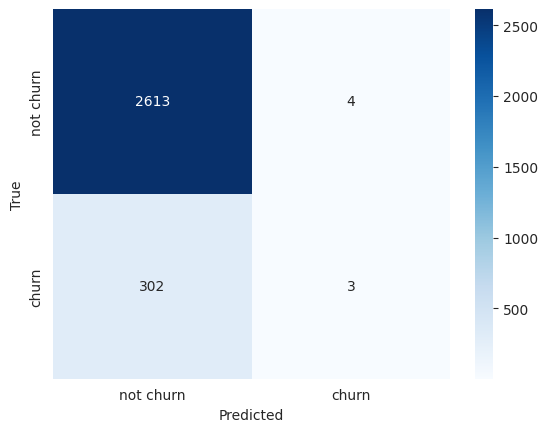

In [20]:
target_names = ['not churn', 'churn']
lr = LogisticRegression()

lr.fit(xtrain,ytrain)

y_pred = lr.predict(xtest)

print(classification_report(ytest, y_pred, target_names=target_names))

LogisticAccuracy = 100*accuracy_score(y_pred, ytest)
LogisticPrecision = 100*precision_score(y_pred, ytest)
LogisticRecall = 100*recall_score(y_pred, ytest)
LogisticF1  = 100*f1_score(y_pred, ytest)

print("Accuracy score on test set:", LogisticAccuracy)
print("Precision score on test set:", LogisticPrecision)
print("Recall score on test set:", LogisticRecall)
print("F1 score on test set:", LogisticF1)


cm = confusion_matrix(ytest, y_pred)

sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

(Asad)


### KNN

In [21]:
accuracy_list = []
precision_list = []
recall_list = []
f1_list = []
models = []

for k in range(1, 30):

    knn = KNeighborsClassifier(n_neighbors=k)
    models.append(knn)
    knn.fit(xtrain, ytrain)

    y_pred = knn.predict(xtest)

    accuracy = 100*accuracy_score(y_pred, ytest)
    precision = 100*precision_score(y_pred, ytest)
    recall = 100*recall_score(y_pred, ytest)
    f1  = 100*f1_score(y_pred, ytest)

    accuracy_list.append(accuracy)
    precision_list.append(precision)
    recall_list.append(recall)
    f1_list.append(f1)


(Parkash)

### Comments

We see that as k increases, all the metrics decrease.

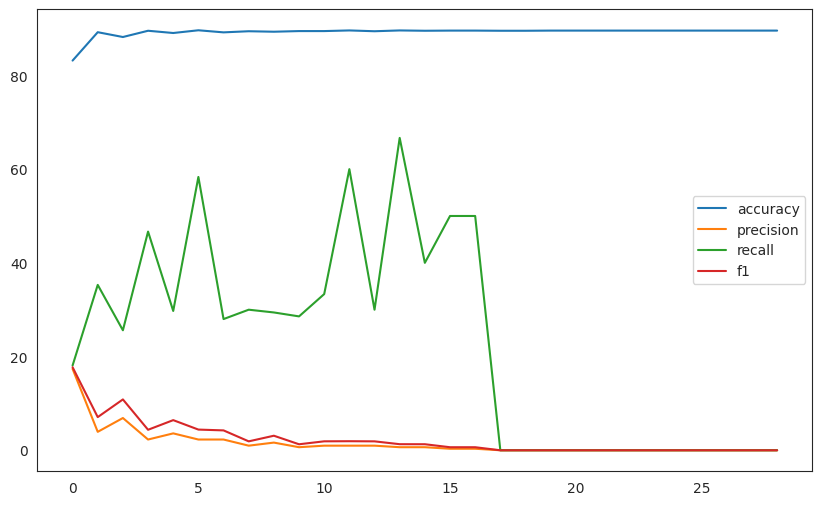

In [22]:
plt.figure(figsize=(10,6))
plt.plot(accuracy_list, label = 'accuracy')
plt.plot(precision_list, label = 'precision')
plt.plot(recall_list, label = 'recall')
plt.plot(f1_list, label = 'f1')
plt.legend()
plt.show()


(Parkash)

              precision    recall  f1-score   support

   not churn       0.90      1.00      0.95      2617
       churn       0.67      0.01      0.01       305

    accuracy                           0.90      2922
   macro avg       0.78      0.50      0.48      2922
weighted avg       0.87      0.90      0.85      2922

Accuracy score on test set: 89.59616700889802
Precision score on test set: 0.6557377049180327
Recall score on test set: 66.66666666666666
F1 score on test set: 1.2987012987012987


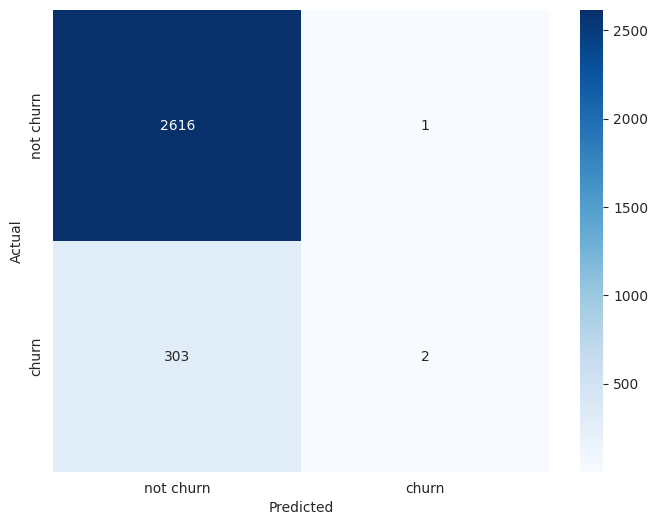

In [23]:
knn = KNeighborsClassifier(n_neighbors=14)
models.append(knn)
knn.fit(xtrain, ytrain)

y_pred = knn.predict(xtest)

print(classification_report(ytest, y_pred, target_names=target_names))


KnnAccuracy = 100*accuracy_score(y_pred, ytest)
KnnPrecision = 100*precision_score(y_pred, ytest)
KnnRecall = 100*recall_score(y_pred, ytest)
KnnF1  = 100*f1_score(y_pred, ytest)

print("Accuracy score on test set:", KnnAccuracy)
print("Precision score on test set:", KnnPrecision)
print("Recall score on test set:", KnnRecall)
print("F1 score on test set:", KnnF1)

cm = confusion_matrix(ytest, y_pred)
plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


(Parkash)

### SVM

              precision    recall  f1-score   support

   not churn       0.90      1.00      0.94      2617
       churn       0.00      0.00      0.00       305

    accuracy                           0.90      2922
   macro avg       0.45      0.50      0.47      2922
weighted avg       0.80      0.90      0.85      2922

Accuracy score on test set: 89.56194387405887
Accuracy score on test set: 89.56194387405887
Precision score on test set: 0.0
Recall score on test set: 0.0
F1 score on test set: 0.0


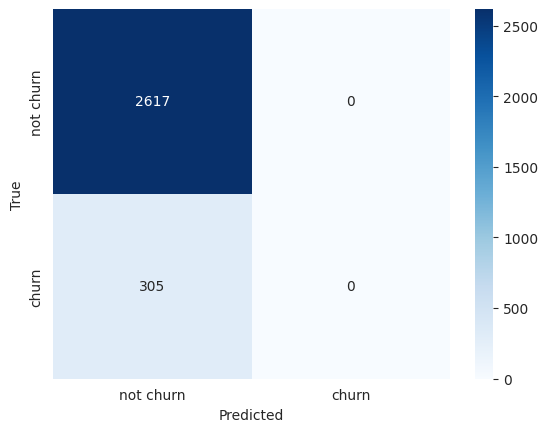

In [24]:
svc = SVC()
svc.fit(xtrain,ytrain)
y_pred = svc.predict(xtest)


print(classification_report(ytest, y_pred, target_names=target_names))

print("Accuracy score on test set:", accuracy)

SVMAccuracy = 100*accuracy_score(y_pred, ytest)
SVMPrecision = 100*precision_score(y_pred, ytest)
SVMRecall = 100*recall_score(y_pred, ytest)
SVMF1  = 100*f1_score(y_pred, ytest)

print("Accuracy score on test set:", SVMAccuracy)
print("Precision score on test set:", SVMPrecision)
print("Recall score on test set:", SVMRecall)
print("F1 score on test set:", SVMF1)

cm = confusion_matrix(ytest, y_pred)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


(Parkash)

### Decision Tree

              precision    recall  f1-score   support

   not churn       0.90      0.98      0.94      2617
       churn       0.40      0.10      0.15       305

    accuracy                           0.89      2922
   macro avg       0.65      0.54      0.55      2922
weighted avg       0.85      0.89      0.86      2922

Accuracy score on train set: 89.56194387405887
Accuracy score on test set: 89.0485968514716
Precision score on test set: 9.508196721311474
Recall score on test set: 39.726027397260275
F1 score on test set: 15.343915343915345


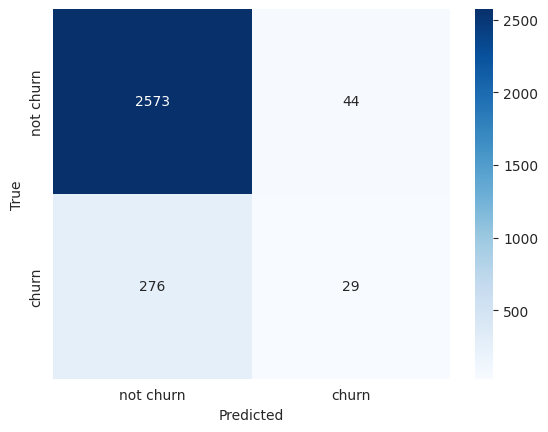

In [25]:
dt = DecisionTreeClassifier(random_state = 4, max_depth=10)
dt.fit(xtrain, ytrain)

y_pred = dt.predict(xtest)

print(classification_report(ytest, y_pred, target_names=target_names))

print("Accuracy score on train set:", accuracy)

DTAccuracy = 100*accuracy_score(y_pred, ytest)
DTPrecision = 100*precision_score(y_pred, ytest)
DTRecall = 100*recall_score(y_pred, ytest)
DTF1  = 100*f1_score(y_pred, ytest)

print("Accuracy score on test set:", DTAccuracy)
print("Precision score on test set:", DTPrecision)
print("Recall score on test set:", DTRecall)
print("F1 score on test set:", DTF1)

cm = confusion_matrix(ytest, y_pred)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

(Asad)


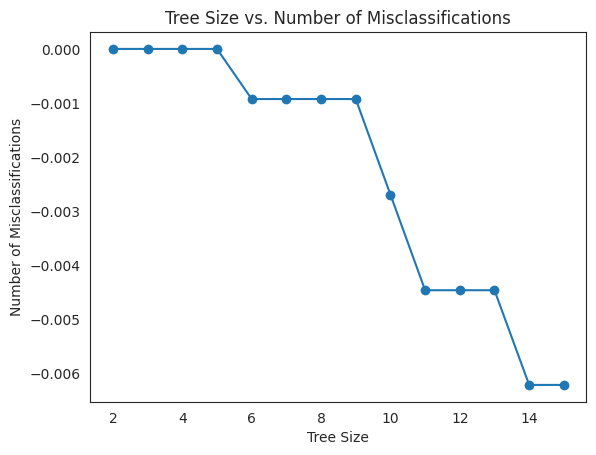

Minimum number of misclassifications -0.006207877090230031
Best tree size 14


In [26]:
param_grid = {'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9,10,11, 12,13, 14, 15]}

kfold = KFold(n_splits=5, shuffle=True, random_state=4)
grid_search = GridSearchCV(DecisionTreeClassifier(random_state = 4), param_grid, cv=kfold, scoring='recall')
grid_search.fit(xtrain, ytrain)

tree_sizes = param_grid['max_leaf_nodes']
misclassifications = -grid_search.cv_results_['mean_test_score']

plt.plot(tree_sizes, misclassifications, marker='o')
plt.xlabel('Tree Size')
plt.ylabel('Number of Misclassifications')
plt.title('Tree Size vs. Number of Misclassifications')
plt.show()

min_misclassification = np.min(misclassifications)
best_tree_size = tree_sizes[np.argmin(misclassifications)]

print("Minimum number of misclassifications", min_misclassification)
print("Best tree size", best_tree_size)

(Asad)

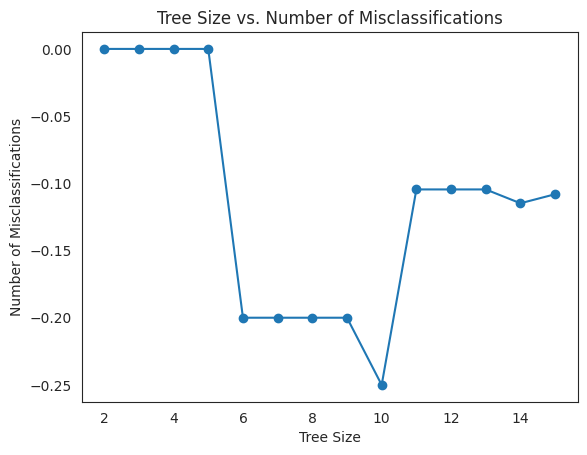

Minimum number of misclassifications -0.25
Best tree size 10


In [27]:
param_grid = {'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9,10,11, 12,13, 14, 15]}

kfold = KFold(n_splits=5, shuffle=True, random_state=4)
grid_search = GridSearchCV(DecisionTreeClassifier(random_state = 4), param_grid, cv=kfold, scoring='precision')
grid_search.fit(xtrain, ytrain)

tree_sizes = param_grid['max_leaf_nodes']
misclassifications = -grid_search.cv_results_['mean_test_score']

plt.plot(tree_sizes, misclassifications, marker='o')
plt.xlabel('Tree Size')
plt.ylabel('Number of Misclassifications')
plt.title('Tree Size vs. Number of Misclassifications')
plt.show()

min_misclassification = np.min(misclassifications)
best_tree_size = tree_sizes[np.argmin(misclassifications)]

print("Minimum number of misclassifications", min_misclassification)
print("Best tree size", best_tree_size)


(Asad)

### Gaussian Naive Bayes

              precision    recall  f1-score   support

   not churn       0.92      0.39      0.54      2617
       churn       0.12      0.72      0.21       305

    accuracy                           0.42      2922
   macro avg       0.52      0.55      0.38      2922
weighted avg       0.84      0.42      0.51      2922

Accuracy score on train set: 89.56194387405887
Accuracy score on test set: 42.06023271731691
Precision score on test set: 72.1311475409836
Recall score on test set: 12.035010940919037
F1 score on test set: 20.628223159868732


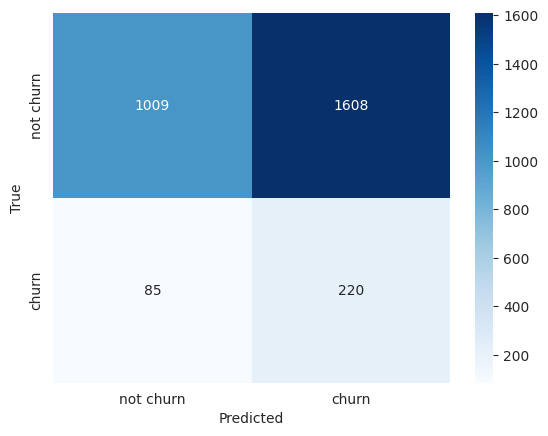

In [28]:
gcla = GaussianNB()
gcla.fit(xtrain, ytrain)
y_pred = gcla.predict_proba(xtest)
y_pred = np.argmax(y_pred, axis = 1)

print(classification_report(ytest, y_pred, target_names=target_names))

print("Accuracy score on train set:", accuracy)

GNBAccuracy = 100*accuracy_score(y_pred, ytest)
GNBPrecision = 100*precision_score(y_pred, ytest)
GNBRecall = 100*recall_score(y_pred, ytest)
GNBF1  = 100*f1_score(y_pred, ytest)

print("Accuracy score on test set:", GNBAccuracy)
print("Precision score on test set:", GNBPrecision)
print("Recall score on test set:", GNBRecall)
print("F1 score on test set:", GNBF1)

cm = confusion_matrix(ytest, y_pred)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


(Asad)

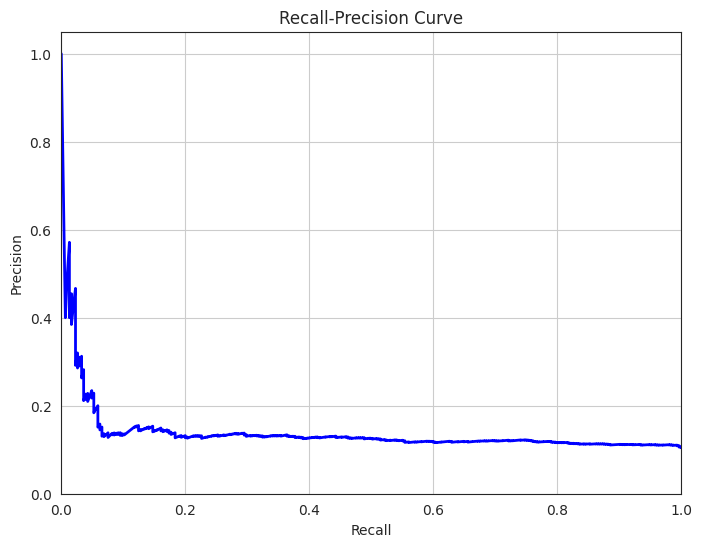

In [29]:
from sklearn.metrics import precision_recall_curve

# Get predicted probabilities of positive class for test data
y_scores = gcla.predict_proba(xtest)[:, 1]

# Calculate precision and recall values
precision, recall, _ = precision_recall_curve(ytest, y_scores)

# Plot the recall-precision curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='blue', linewidth=2)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Recall-Precision Curve')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.grid(True)
plt.show()


(Asad)

### Gradient Boosting Classifier

              precision    recall  f1-score   support

   not churn       0.90      1.00      0.94      2617
       churn       0.00      0.00      0.00       305

    accuracy                           0.90      2922
   macro avg       0.45      0.50      0.47      2922
weighted avg       0.80      0.90      0.85      2922

Accuracy score on test set: 89.56194387405887
Accuracy score on test set: 89.56194387405887
Precision score on test set: 0.0
Recall score on test set: 0.0
F1 score on test set: 0.0


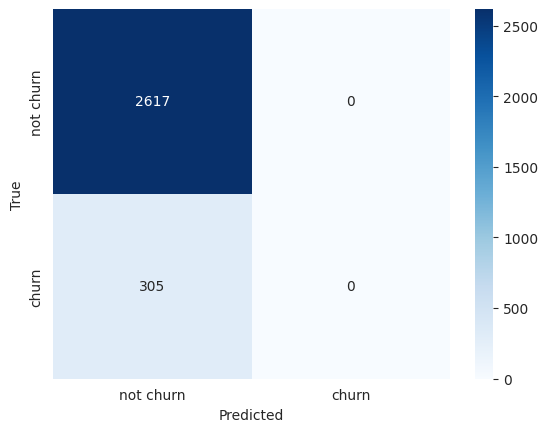

In [30]:
gb = GradientBoostingClassifier(n_estimators=20)
gb.fit(xtrain,ytrain)
y_pred = gb.predict(xtest)
print(classification_report(ytest, y_pred, target_names=target_names))

print("Accuracy score on test set:", accuracy)

GBAccuracy = 100*accuracy_score(y_pred, ytest)
GBPrecision = 100*precision_score(y_pred, ytest)
GBRecall = 100*recall_score(y_pred, ytest)
GBF1  = 100*f1_score(y_pred, ytest)

print("Accuracy score on test set:", GBAccuracy)
print("Precision score on test set:", GBPrecision)
print("Recall score on test set:", GBRecall)
print("F1 score on test set:", GBF1)

cm = confusion_matrix(ytest, y_pred)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


(Parkash)


### Random Forest

              precision    recall  f1-score   support

   not churn       0.90      1.00      0.95      2617
       churn       0.93      0.04      0.08       305

    accuracy                           0.90      2922
   macro avg       0.91      0.52      0.51      2922
weighted avg       0.90      0.90      0.86      2922

Accuracy score on test set: 89.56194387405887
Accuracy score on test set: 89.97262149212868
Precision score on test set: 4.2622950819672125
Recall score on test set: 92.85714285714286
F1 score on test set: 8.150470219435736


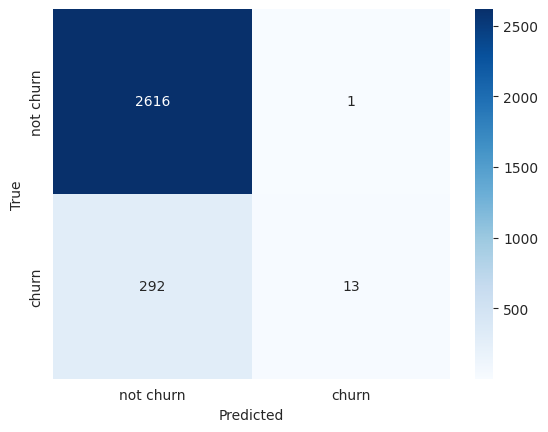

In [31]:
rf = RandomForestClassifier(random_state = 4)
rf.fit(xtrain,ytrain)
y_pred = rf.predict(xtest)
print(classification_report(ytest, y_pred, target_names=target_names))

print("Accuracy score on test set:", accuracy)

RFAccuracy = 100*accuracy_score(y_pred, ytest)
RFPrecision = 100*precision_score(y_pred, ytest)
RFRecall = 100*recall_score(y_pred, ytest)
RFF1  = 100*f1_score(y_pred, ytest)

print("Accuracy score on test set:", RFAccuracy)
print("Precision score on test set:", RFPrecision)
print("Recall score on test set:", RFRecall)
print("F1 score on test set:", RFF1)

cm = confusion_matrix(ytest, y_pred)
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=target_names, yticklabels=target_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


(Parkash)

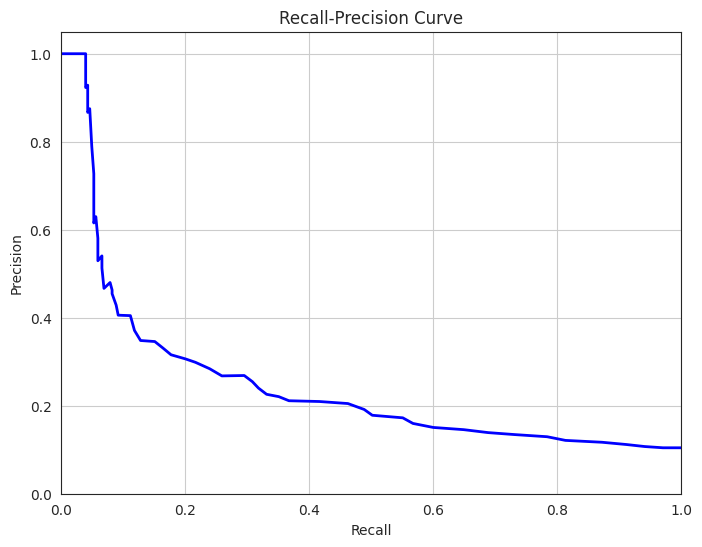

In [32]:
from sklearn.metrics import precision_recall_curve

# Get predicted probabilities of positive class for test data
y_scores = rf.predict_proba(xtest)[:, 1]

# Calculate precision and recall values
precision, recall, _ = precision_recall_curve(ytest, y_scores)

# Plot the recall-precision curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='blue', linewidth=2)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Recall-Precision Curve')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.grid(True)
plt.show()


(Asad)

# Plotting all metrics of all models togather

In [33]:
Accuracy_scores = [LogisticAccuracy, KnnAccuracy, SVMAccuracy, DTAccuracy, GNBAccuracy, GBAccuracy, RFAccuracy]
Precision_scores = [LogisticPrecision, KnnPrecision, SVMPrecision, DTPrecision, GNBPrecision, GBPrecision, RFPrecision]
Recall_scores = [LogisticRecall, KnnRecall, SVMRecall, DTRecall, GNBRecall, GBRecall, RFRecall]
F1_scores = [LogisticF1, KnnF1, SVMF1, DTF1, GNBF1, GBF1, RFF1]

(Parkash)

<Figure size 1200x600 with 0 Axes>

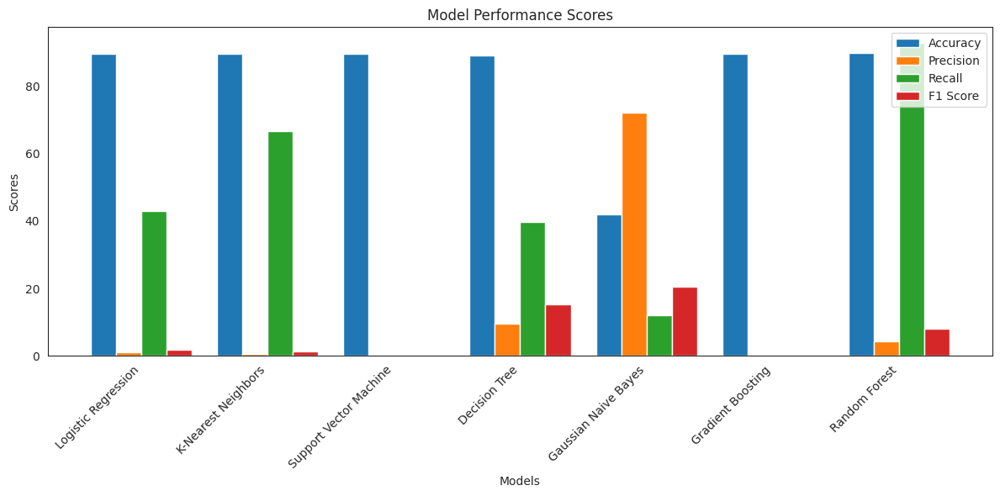

In [34]:
import matplotlib.pyplot as plt

labels = ['Logistic Regression', 'K-Nearest Neighbors', 'Support Vector Machine', 'Decision Tree',
          'Gaussian Naive Bayes', 'Gradient Boosting', 'Random Forest']

legends = ['accuracy', 'precision', 'recall', 'f1']

# Create a figure and axis
plt.figure(figsize=(12, 6))
fig, ax = plt.subplots(figsize=(12, 6))

# Set the width of each bar
bar_width = 0.2

# Positions for the bars
x_positions = np.arange(len(labels))

# Plot the bars for each score type
ax.bar(x_positions - 1.5 * bar_width, Accuracy_scores, width=bar_width, label='Accuracy')
ax.bar(x_positions - 0.5 * bar_width, Precision_scores, width=bar_width, label='Precision')
ax.bar(x_positions + 0.5 * bar_width, Recall_scores, width=bar_width, label='Recall')
ax.bar(x_positions + 1.5 * bar_width, F1_scores, width=bar_width, label='F1 Score')

# Set the x-axis ticks and labels
ax.set_xticks(x_positions)
ax.set_xticklabels(labels, rotation=45, ha='right')

# Set labels and title
ax.set_xlabel('Models')
ax.set_ylabel('Scores')
ax.set_title('Model Performance Scores')

# Add a legend
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()


(Parkash)

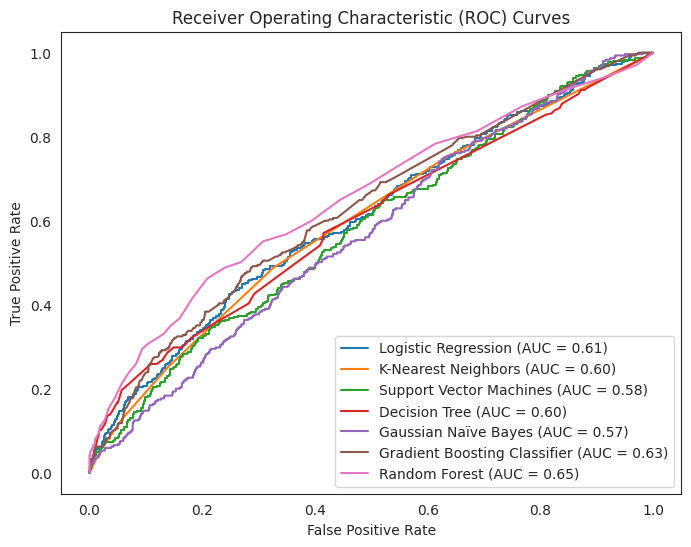

In [35]:
y_pred_lr = lr.predict_proba(xtest)[:, 1]  # Logistic Regression
y_pred_knn = knn.predict_proba(xtest)[:, 1]  # K-Nearest Neighbors
y_pred_svm = svc.decision_function(xtest)  # Support Vector Machines
y_pred_dt = dt.predict_proba(xtest)[:, 1]  # Decision Tree
y_pred_gnb = gcla.predict_proba(xtest)[:, 1]  # Gaussian Naïve Bayes
y_pred_gbc = gb.predict_proba(xtest)[:, 1]  # Gradient Boosting Classifier
y_pred_rf = rf.predict_proba(xtest)[:, 1]  # Random Forest

# Compute FPR, TPR, and thresholds for each model
fpr_lr, tpr_lr, thresholds_lr = roc_curve(ytest, y_pred_lr)
fpr_knn, tpr_knn, thresholds_knn = roc_curve(ytest, y_pred_knn)
fpr_svm, tpr_svm, thresholds_svm = roc_curve(ytest, y_pred_svm)
fpr_dt, tpr_dt, thresholds_dt = roc_curve(ytest, y_pred_dt)
fpr_gnb, tpr_gnb, thresholds_gnb = roc_curve(ytest, y_pred_gnb)
fpr_gbc, tpr_gbc, thresholds_gbc = roc_curve(ytest, y_pred_gbc)
fpr_rf, tpr_rf, thresholds_rf = roc_curve(ytest, y_pred_rf)

# Calculate AUC for each model
auc_lr = auc(fpr_lr, tpr_lr)
auc_knn = auc(fpr_knn, tpr_knn)
auc_svm = auc(fpr_svm, tpr_svm)
auc_dt = auc(fpr_dt, tpr_dt)
auc_gnb = auc(fpr_gnb, tpr_gnb)
auc_gbc = auc(fpr_gbc, tpr_gbc)
auc_rf = auc(fpr_rf, tpr_rf)

# Plot ROC curves
plt.figure(figsize=(8, 6))
plt.plot(fpr_lr, tpr_lr, label='Logistic Regression (AUC = %0.2f)' % auc_lr)
plt.plot(fpr_knn, tpr_knn, label='K-Nearest Neighbors (AUC = %0.2f)' % auc_knn)
plt.plot(fpr_svm, tpr_svm, label='Support Vector Machines (AUC = %0.2f)' % auc_svm)
plt.plot(fpr_dt, tpr_dt, label='Decision Tree (AUC = %0.2f)' % auc_dt)
plt.plot(fpr_gnb, tpr_gnb, label='Gaussian Naïve Bayes (AUC = %0.2f)' % auc_gnb)
plt.plot(fpr_gbc, tpr_gbc, label='Gradient Boosting Classifier (AUC = %0.2f)' % auc_gbc)
plt.plot(fpr_rf, tpr_rf, label='Random Forest (AUC = %0.2f)' % auc_rf)

# Add legend, axis labels, and title
plt.legend(loc='lower right')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curves')

# Show the plot
plt.show()


(Asad)

### Conclusion:
    
    Since our target variable churn is highly imbalanced, so we will consider recall as the metric of our interest.
    
    We can see that Random Forest and Gaussian Naive Bayes give us the optimal levels of Recall and Precision.
    

### Parkash Meghwar & Asad Sajid